In [1]:
import cobra
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import graph_utils as gu
from optlang.symbolics import Zero
from itertools import chain, combinations, combinations_with_replacement
import networkx as nx
import json
from amg_utils import amg_limits

In [34]:
masses = json.loads(open("model_files/masses.json").read())
manual_relabels = json.loads(open("model_files/subsystem_alias.json").read())
amgs = json.loads(open("model_files/amg_reactions.json").read())

In [5]:
model = cobra.io.read_sbml_model("./model_files/ProchlorococcusMED4+PHM2v1.xml")

In [73]:
# from memote
def is_only_substrate(metabolite: cobra.Metabolite, reaction: cobra.Reaction) -> bool:
    """Determine if a metabolite is only a substrate of a reaction."""
    if reaction.reversibility:
        return False
    if reaction.get_coefficient(metabolite) < 0:
        return reaction.lower_bound >= 0.0 and reaction.upper_bound > 0
    else:
        return reaction.lower_bound < 0.0 and reaction.upper_bound <= 0


def is_only_product(metabolite: cobra.Metabolite, reaction: cobra.Reaction) -> bool:
    """Determine if a metabolite is only a product of a reaction."""
    if reaction.reversibility:
        return False
    if reaction.get_coefficient(metabolite) > 0:
        return reaction.lower_bound >= 0.0 and reaction.upper_bound > 0
    else:
        return reaction.lower_bound < 0.0 and reaction.upper_bound <= 0


exchanges = frozenset(model.exchanges)
orphans = [
    met.id
    for met in model.metabolites
    if (len(met.reactions) > 0)
    and all(is_only_substrate(met, rxn) for rxn in met.reactions)
    or (len(met.reactions) == 1)
]
deadends = [
    met.id
    for met in model.metabolites
    if (len(met.reactions) > 0)
    and all(is_only_product(met, rxn) for rxn in met.reactions)
    or (len(met.reactions) == 1)
]

print(set([ex.subsystem for ex in exchanges]))
print()
print(orphans)
print()
print(deadends)

isolates = [
    set(rxn.subsystem for rxn in model.metabolites.get_by_id(mid).reactions)
    for mid in set(chain(orphans, deadends))
]
isolates = sorted(set(chain(*isolates)))
print()
print(isolates)
ns = sorted(
    list(chain(g_healthy.successors("External"), g_healthy.predecessors("External")))
)
print(ns)
print(len(isolates))
print(len(ns))

s = 0
for u, v, d in g_healthy.edges(data=True):
    if u == "External" or v == "External":
        print(u, v, d["weight"])
        if u == "External":
            s += d["weight"]
        else:
            s -= d["weight"]
print(s)

{'', 'Exchange Reaction'}

['Sucrose[c]', 'Glycerone[c]', 'GDP_L_fucose[c]', 'UDP_D_galacturonate[c]', 'D_Mannose_1_phosphate[c]', 'D_Ribose_1_5_bisphosphate[c]', 'Phosphonate[c]', 'Pseudouridine_5_phosphate[c]', 'Sucrose_6_phosphate[c]', 'Selenophosphoric_acid[c]', 'Heme_O[c]', 'N_Acetylornithine[e]', '7_Aminomethyl_7_carbaguanine[e]', 'trans_Dodec_2_enoyl_[acp][c]', '5_Phospho_DNAm[c]', 'm[c]', 'Protochlorophyllide[c]', 'e_[c]', 'Biotinyl_5_AMP[c]', 'L_Threonylcarbamoyladenylate[c]', 'Folinic_acid[c]', 'Hydroxyproline[c]', 'Sulfur_carrier_protein[c]', 'Propanoate[c]', '2_Phytyl_1_4_naphthoquinone[c]', 'Demethylphylloquinol[c]', 'Reduced_acceptor[c]', 'Thiocarboxy_[sulfur_carrier_protein][c]', 'Acceptor[c]', 'Cobalt_precorrin_4[c]', 'Cobalt_precorrin_6[c]', 'UDPMurNAcoyl_L_Ala_D_gamma_Glu_L_Lys_D_Ala_D_Ala[c]', 'MurAcoyl_L_Ala_D_gamma_Glu_L_Lys_D_Ala_D_Ala_diphospho_undecaprenol[c]', 'Aldehyde[c]', 'Fatty_acid[c]', 'Pyridinium_3_5_bisthiocarboxylate_mononucleotide[c]', 'Oxidized_plast

In [71]:
gm_mets = set()
for rxn in model.reactions:
    if rxn.subsystem == "Glycerophospholipid metabolism":
        print(rxn)
        gm_mets |= set(m.id for m in rxn.metabolites)
print()
for m in gm_mets:
    print(m, masses[m])
print()
for m in gm_mets:
    print(m, model.metabolites.get_by_id(m).formula)

R01799: CTP[c] + Phosphatidate[c] --> CDP_diacylglycerol[c] + Diphosphate[c]
R01801: CDP_diacylglycerol[c] + sn_Glycerol_3_phosphate[c] --> CMP[c] + Phosphatidylglycerophosphate[c]
R02029: H2O[c] + Phosphatidylglycerophosphate[c] --> Orthophosphate[c] + Phosphatidylglycerol[c]

Phosphatidate[c] 225.98785418059
CMP[c] 323.05185141949
sn_Glycerol_3_phosphate[c] 172.01367500591002
Orthophosphate[c] 97.97689557339001
Diphosphate[c] 177.94322646275
H2O[c] 18.01056468403
CTP[c] 482.98451319821
Phosphatidylglycerol[c] 300.02463361311
CDP_diacylglycerol[c] 531.02914091605
Phosphatidylglycerophosphate[c] 379.99096450247

Phosphatidate[c] C5H7O8PR2
CMP[c] C9H14N3O8P
sn_Glycerol_3_phosphate[c] C3H9O6P
Orthophosphate[c] H3O4P
Diphosphate[c] H4O7P2
H2O[c] H2O
CTP[c] C9H16N3O14P3
Phosphatidylglycerol[c] C8H13O10P
CDP_diacylglycerol[c] C14H19N3O15P2R2
Phosphatidylglycerophosphate[c] C8H14O13P2R2


In [67]:
model.metabolites.get_by_id("sn_Glycerol_3_phosphate[c]")

Metabolite identifier,sn_Glycerol_3_phosphate[c]
Name,sn-Glycerol 3-phosphate
Memory address,0x164e70b8800
Formula,C3H9O6P
Compartment,c
In 8 reaction(s),"R00841, R00851C180R02241C180, R00851C160R02241C160, R12241, R01801, R00851C1819R02241C1819, PhospholipidTRANS, R00851C182912R02241C182912"


In [6]:
def nearest_ind(df, v):
    return min(range(len(df.index)), key=lambda x: abs(df.index[x] - v))


def flux_at_val(df, v):
    return df.iloc[nearest_ind(df, v), 0].fluxes

In [21]:
with model as host_model:
    h_fva = cobra.flux_analysis.flux_variability_analysis(
        host_model,
        [
            host_model.reactions.AmmoniaEX,
            host_model.reactions.FAKEOrthophosphateEX,
            host_model.reactions.HCO3EXcar,
            host_model.reactions.LightEX,
        ],
    )
with model as phage_model:
    phage_model.objective = phage_model.reactions.PHM2_prodrxn_VN.flux_expression
    p_fva = cobra.flux_analysis.flux_variability_analysis(
        phage_model,
        [
            phage_model.reactions.AmmoniaEX,
            phage_model.reactions.FAKEOrthophosphateEX,
            phage_model.reactions.HCO3EXcar,
            phage_model.reactions.LightEX,
        ],
    )

print("Host-optimal")
print(h_fva)
print()
print("Phage-optimal")
print(p_fva)

Host-optimal
                          minimum    maximum
AmmoniaEX               -0.864117  -0.855149
FAKEOrthophosphateEX    -0.033099  -0.033099
HCO3EXcar            -1000.000000  -5.341752
LightEX              -1000.000000 -72.510110

Phage-optimal
                          minimum    maximum
AmmoniaEX               -1.637692  -1.637692
FAKEOrthophosphateEX    -0.187383  -0.187383
HCO3EXcar            -1000.000000  -4.917245
LightEX              -1000.000000 -56.503374


Based on the above, we will set some (highly permissive) bounds on maximum nutrient uptake

In [22]:
BOUND_FACTOR = 5
N_LIMIT = -0.86 * BOUND_FACTOR
P_LIMIT = -0.18 * BOUND_FACTOR
C_LIMIT = -5.4 * BOUND_FACTOR
L_LIMIT = -73 * BOUND_FACTOR

In [ ]:
def amg_impact_by_parsimony(
    model,
    amgs,
    optimum_tolerance=0.5,
    new_amg_penalty=0,
):
    with model as imodel:
        biomass = imodel.slim_optimize()
        imodel.reactions.BIOMASS.lower_bound = biomass * (1 - optimum_tolerance)

        # Do not allow the cell to uptake too much to feed prioritized reactions
        imodel.reactions.AmmoniaEX.bounds = (
            N_LIMIT,
            0,
        )
        imodel.reactions.FAKEOrthophosphateEX.bounds = (
            P_LIMIT,
            0,
        )
        imodel.reactions.HCO3EXcar.bounds = (
            C_LIMIT,
            0,
        )
        imodel.reactions.LightEX.bounds = (
            L_LIMIT,
            0,
        )

        # parsimony only applies to gene-regulated reactions here
        rxn_list = [rxn for rxn in imodel.reactions if rxn.genes or rxn.id in amgs]

        reaction_variables = (
            (rxn.forward_variable, rxn.reverse_variable) for rxn in rxn_list
        )
        reaction_is_doubled = ((rxn.id, rxn.id) for rxn in rxn_list)
        id_var = zip(chain(*reaction_is_doubled), chain(*reaction_variables))

        # Infected
        imodel.objective = imodel.problem.Objective(
            Zero, direction="min", sloppy=True, name="_pfba_objective"
        )

        coeff = {}
        forward = True
        for rid, v in id_var:
            if rid in amgs and amgs[rid] == "raw increase":
                if forward:
                    coeff[v] = 1.0 - abs(new_amg_penalty)
                else:
                    coeff[v] = 1.0 + abs(new_amg_penalty)
            elif rid in amgs and amgs[rid] == "raw decrease":
                if forward:
                    coeff[v] = 1.0 + abs(new_amg_penalty)
                else:
                    coeff[v] = 1.0 - abs(new_amg_penalty)
            elif rid in amgs and amgs[rid] == "absolute increase":
                if forward:
                    coeff[v] = 1.0 - abs(new_amg_penalty)
                else:
                    coeff[v] = 1.0 - abs(new_amg_penalty)
            elif rid in amgs and amgs[rid] == "absolute decrease":
                if forward:
                    coeff[v] = 1.0 + abs(new_amg_penalty)
                else:
                    coeff[v] = 1.0 + abs(new_amg_penalty)
            else:
                coeff[v] = 1.0
            forward = not forward
        imodel.objective.set_linear_coefficients(coeff)
        infected = imodel.optimize()

        return infected


def draw_graph(gs, ax, manual_relabels=None, cut=0.3, pos=None, scale=1):
    if manual_relabels is None:
        manual_relabels = {}
    gs_red = gs.edge_subgraph(
        [(u, v) for u, v, d in gs.edges(data=True) if np.abs(d["weight"] / scale) > cut]
    )

    if pos is None:
        pos = nx.shell_layout(gs_red)
    nx.draw_networkx_nodes(
        gs_red,
        pos=pos,
        ax=ax,
        alpha=0.5,
        node_size=[
            50 * np.sqrt(np.abs(gs.in_degree(n, weight="weight") / scale))
            for n in gs_red.nodes
        ],
        node_color=[
            "#aaaaff" if gs.in_degree(n, weight="weight") > 0 else "#ffaaaa"
            for n in gs_red.nodes
        ],
    )

    # draw node labels by hand becasue nx.draw_networkx_labels can't rotate labels
    for label, (x, y) in pos.items():
        if label not in gs_red.nodes():
            continue
        if label in manual_relabels:
            lab = manual_relabels[label]
        else:
            lab = label
        ax.text(
            x,
            y,
            lab,
            fontsize=12,
            ha="center",
            va="center",
            rotation=15,
        )

    nx.draw_networkx_edges(
        gs_red,
        pos=pos,
        edge_color=[
            "#aaaaff" if d["weight"] > 0 else "#ffaaaa"
            for _, _, d in gs_red.edges(data=True)
        ],
        alpha=[
            min((np.abs(d["weight"] / scale) / 100) ** (1 / 4), 1)
            for _, _, d in gs_red.edges(data=True)
        ],
        connectionstyle="arc3, rad = 0.1",
        arrowsize=20,
        width=[
            np.log(np.abs(d["weight"] / scale)) for _, _, d in gs_red.edges(data=True)
        ],
        ax=ax,
    )
    ax.set_frame_on(False)

In [30]:
baselines = []
infecteds = []
diffs = []
penalties = np.linspace(0, 10, 111)
baseline = amg_impact_by_parsimony(model, amgs, new_amg_penalty=0)
for amg_penalty in penalties:
    infected = amg_impact_by_parsimony(model, amgs, new_amg_penalty=-amg_penalty)
    diff = infected.fluxes - baseline.fluxes
    baselines.append(baseline)
    infecteds.append(infected)
    diffs.append(diff)

baselines = pd.DataFrame(baselines, index=penalties)
infecteds = pd.DataFrame(infecteds, index=penalties)

absdiffs = pd.DataFrame(
    [
        infected.fluxes.abs() - baseline.fluxes.abs()
        for infected, baseline in zip(
            infecteds.values.flatten(), baselines.values.flatten()
        )
    ],
    index=penalties,
)

diffs = pd.DataFrame(diffs, index=penalties)
diffs

,R01055,R00546,R05605,R00346,R00355,R00357,R00369,R00485,R00489,R00768,...,R05681,R04439,R02097,Trans_S_Malate,S_MalateEX,R01078,Trans_H2O2,H2O2EX,R02036,PHM2_prodrxn_VN
0.000000,0.0,0.0,1.075806e-13,0.0,-5.304091e-14,0.0,-4.642120e-15,9.697104e-16,6.884684e-17,6.895526e-16,...,0.0,0.0,0.0,0.0,0.0,0.0,-2.412133e-15,-2.412133e-15,1.076916e-13,0.0
0.090909,0.0,0.0,1.250111e-13,0.0,-2.450817e-14,0.0,-5.429684e-15,1.133642e-15,6.884684e-17,8.066464e-16,...,0.0,0.0,0.0,0.0,0.0,0.0,2.688821e-16,2.688821e-16,1.250111e-13,0.0
0.181818,0.0,0.0,1.042499e-13,0.0,-4.898859e-14,0.0,-4.763551e-15,9.861903e-16,0.000000e+00,7.082009e-16,...,0.0,0.0,0.0,0.0,0.0,0.0,-6.846086e-15,-6.846086e-15,1.042499e-13,0.0
0.272727,0.0,0.0,1.175726e-13,0.0,-6.367129e-14,0.0,-4.902329e-15,1.023487e-15,6.884684e-17,7.281502e-16,...,0.0,0.0,0.0,0.0,0.0,0.0,-1.352217e-15,-1.352217e-15,1.175726e-13,0.0
0.363636,0.0,0.0,1.175726e-13,0.0,-6.367129e-14,0.0,-4.902329e-15,1.023487e-15,6.884684e-17,7.281502e-16,...,0.0,0.0,0.0,0.0,0.0,0.0,-1.352217e-15,-1.352217e-15,1.175726e-13,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9.636364,0.0,0.0,2.956524e-13,0.0,3.771983e-14,0.0,-1.131040e-14,2.362693e-15,-1.256048e-16,1.679646e-15,...,0.0,0.0,0.0,0.0,0.0,0.0,4.930084e-15,4.930084e-15,2.956524e-13,0.0
9.727273,0.0,0.0,2.956524e-13,0.0,3.771983e-14,0.0,-1.131040e-14,2.362693e-15,-1.256048e-16,1.679646e-15,...,0.0,0.0,0.0,0.0,0.0,0.0,4.930084e-15,4.930084e-15,2.956524e-13,0.0
9.818182,0.0,0.0,2.956524e-13,0.0,3.771983e-14,0.0,-1.131040e-14,2.362693e-15,-1.256048e-16,1.679646e-15,...,0.0,0.0,0.0,0.0,0.0,0.0,4.930084e-15,4.930084e-15,2.956524e-13,0.0
9.909091,0.0,0.0,2.956524e-13,0.0,3.771983e-14,0.0,-1.131040e-14,2.362693e-15,-1.256048e-16,1.679646e-15,...,0.0,0.0,0.0,0.0,0.0,0.0,4.930084e-15,4.930084e-15,2.956524e-13,0.0


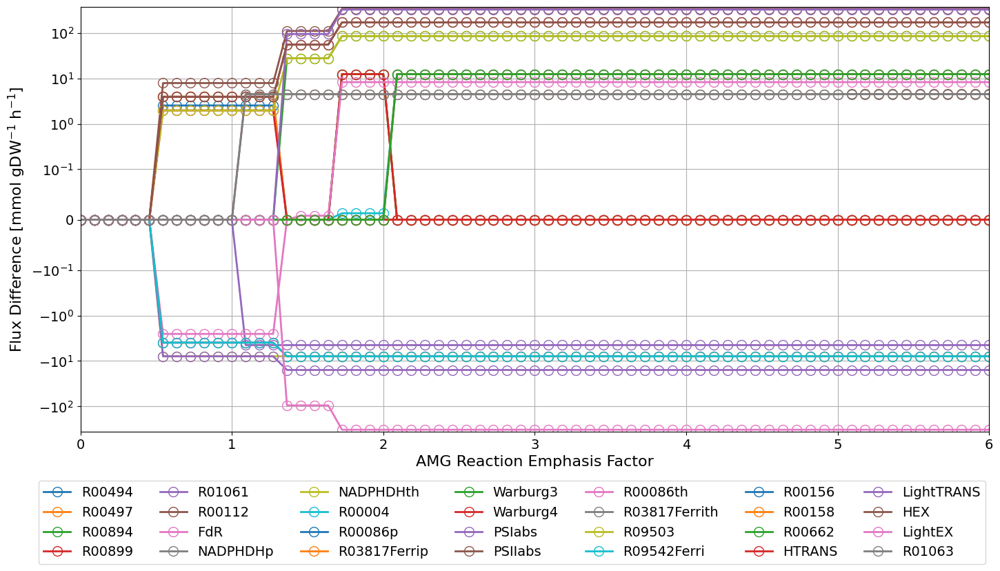

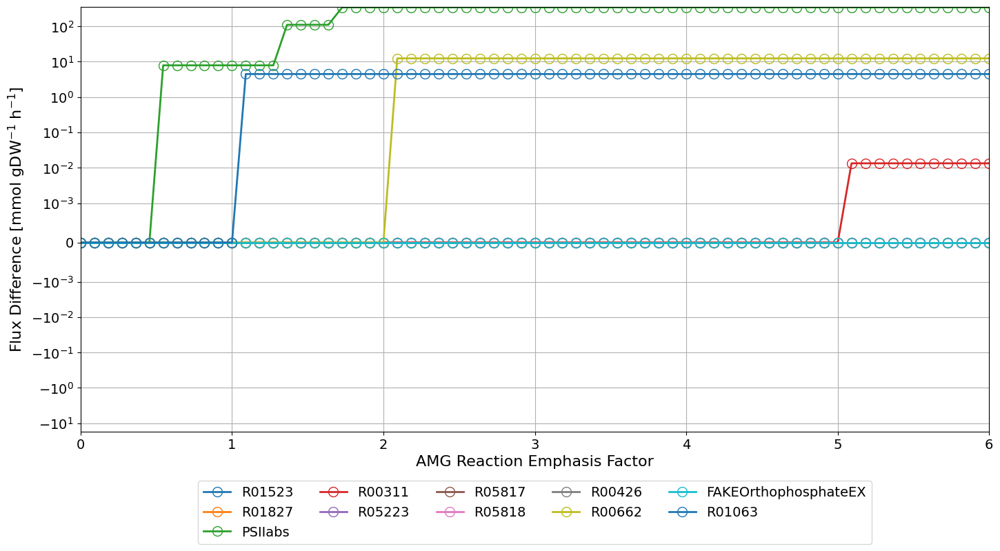

In [ ]:
ax = diffs[[col for col in diffs.columns if (diffs[col].abs().max() > 0.1)]].plot(
    figsize=(17, 8),
    marker="o",
    fillstyle="none",
    linewidth=2,
    markersize=10,
)
ax.set_yscale("symlog", linthresh=1e-1)
plt.tick_params(labelsize=14)
ax.legend(ncols=7, loc="upper center", bbox_to_anchor=(0.475, -0.1), fontsize=14)
ax.set_xlim(0, 6)
ax.set_xlabel("AMG Reaction Emphasis Factor", fontsize=16)
ax.set_ylabel(r"Flux Difference [mmol gDW$^{-1}$ h$^{-1}$]", fontsize=16)
ax.grid(True, which="both")
plt.show()
ax = (
    diffs[[col for col in absdiffs.columns if (col in amgs)]]
    # * np.random.uniform(0.9, 1.1, (len(diffs), 10)) # uncomment to add noise to check for overlap
).plot(
    figsize=(17, 8),
    marker="o",
    fillstyle="none",
    linewidth=2,
    markersize=10,
)
ax.set_yscale("symlog", linthresh=1e-3)
plt.tick_params(labelsize=14)
ax.legend(ncols=5, loc="upper center", bbox_to_anchor=(0.5, -0.1), fontsize=14)
ax.set_xlim(0, 6)
ax.set_xlabel("AMG Reaction Emphasis Factor", fontsize=16)
ax.set_ylabel(r"Flux Difference [mmol gDW$^{-1}$ h$^{-1}$]", fontsize=16)
ax.grid(True, which="both")
plt.show()

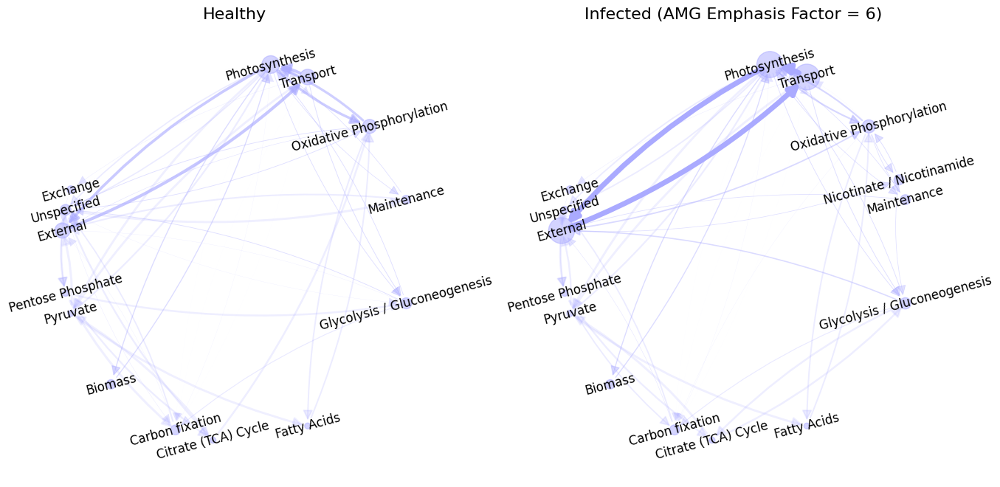

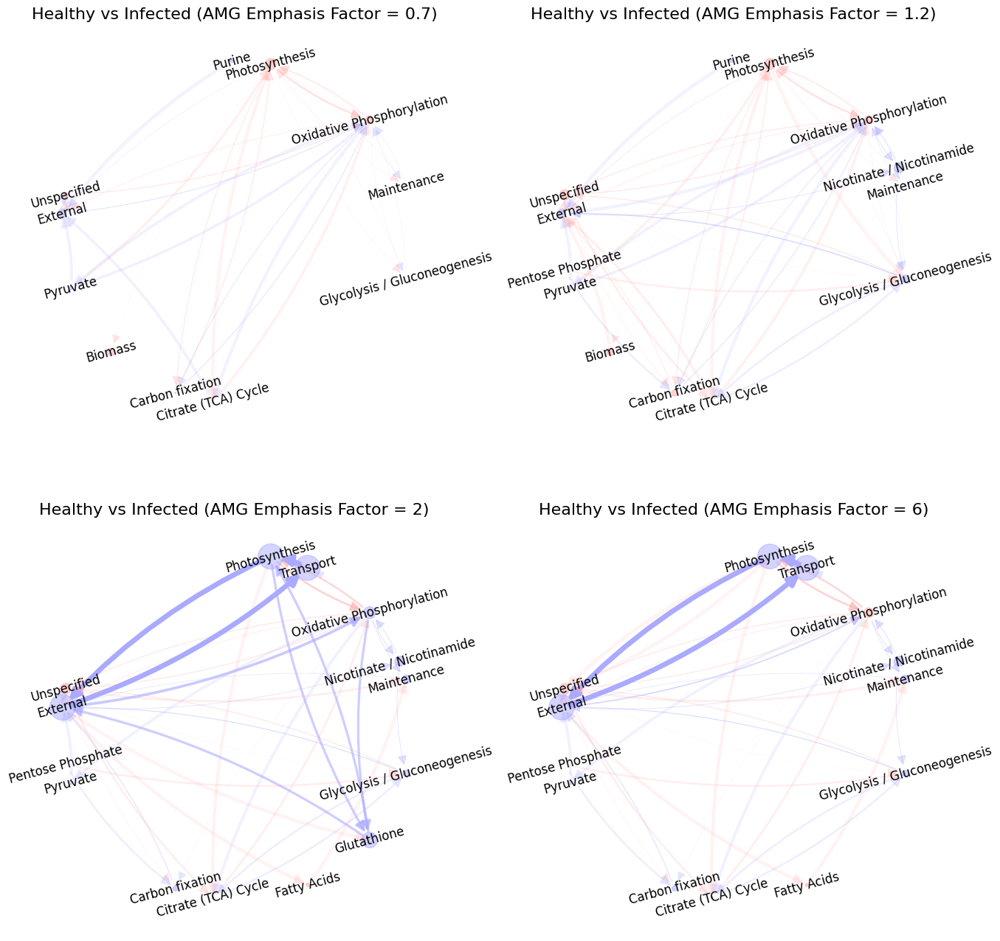

In [35]:
factor = 6
g_healthy = gu.subsystem_flux_graph(
    model,
    flux_at_val(baselines, factor),
    masses=masses,
)
g_infected = gu.subsystem_flux_graph(
    model,
    flux_at_val(infecteds, factor),
    masses=masses,
)
pos = nx.shell_layout(g_infected)
fig, axs = plt.subplots(1, 2, figsize=(16, 8))
draw_graph(
    g_healthy, axs[0], manual_relabels=manual_relabels, scale=300, pos=pos, cut=0.1
)
draw_graph(
    g_infected, axs[1], manual_relabels=manual_relabels, scale=300, pos=pos, cut=0.1
)
axs[0].set_title("Healthy", fontsize=16)
axs[1].set_title(f"Infected (AMG Emphasis Factor = {factor})", fontsize=16)
plt.show()

fig, axs = plt.subplots(2, 2, figsize=(16, 16))
flist = [0.7, 1.2, 2, 6]
scale = 300
cut = 10 / scale
# pos = None
pg = nx.DiGraph()
for r in range(2):
    for ax, factor in zip(axs.flatten(), flist):
        g_healthy = gu.subsystem_flux_graph(
            model,
            flux_at_val(baselines, factor),
            masses=masses,
        )
        g_infected = gu.subsystem_flux_graph(
            model,
            flux_at_val(infecteds, factor),
            masses=masses,
        )

        g_diff = gu.diff_graph(g_infected, g_healthy)

        gs_red = g_diff.edge_subgraph(
            [
                (u, v)
                for u, v, d in g_diff.edges(data=True)
                if np.abs(d["weight"] / scale) > cut
            ]
        )
        if r:
            if pos is None:
                pos = nx.shell_layout(pg)
            draw_graph(
                g_diff,
                ax,
                cut=cut,
                manual_relabels=manual_relabels,
                pos=pos,
                scale=scale,
            )
            ax.set_title(
                f"Healthy vs Infected (AMG Emphasis Factor = {factor})", fontsize=16
            )
        else:
            pg.add_edges_from(gs_red.edges())
plt.show()

In [37]:
sys_diffs_in = {}
for factor in penalties:
    g_infected = gu.subsystem_flux_graph(
        model,
        flux_at_val(infecteds, factor),
        masses=masses,
    )
    g_healthy = gu.subsystem_flux_graph(
        model,
        flux_at_val(baselines, factor),
        masses=masses,
    )

    g_diff = gu.diff_graph(g_infected, g_healthy)
    # g_diff = g_healthy
    # g_diff = g_infected
    if "AMG Emphasis Factor" in sys_diffs_in:
        sys_diffs_in["AMG Emphasis Factor"].append(factor)
    else:
        sys_diffs_in["AMG Emphasis Factor"] = [factor]
    for u in g_diff.nodes():
        deg = g_diff.in_degree(u, weight="weight")
        if u in sys_diffs_in:
            sys_diffs_in[u].append(deg / 1000)
        else:
            sys_diffs_in[u] = [deg / 1000]

sys_diffs_in = pd.DataFrame(sys_diffs_in)
sys_diffs_in.columns = [manual_relabels.get(u, u) for u in sys_diffs_in.columns]


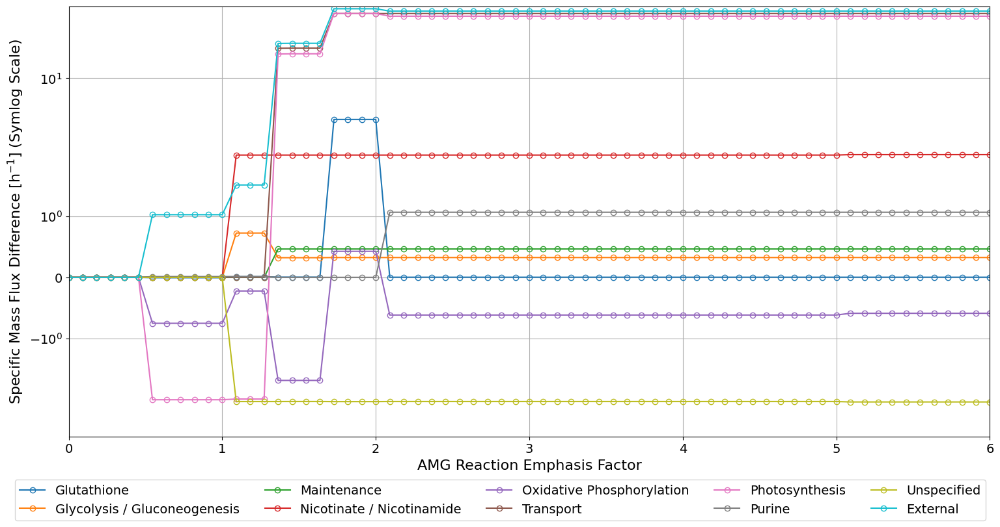

In [39]:
fig, ax = plt.subplots(1, 1, figsize=(16, 8), sharex=True)

ax = sys_diffs_in[
    [
        col
        for col in sys_diffs_in.columns
        if (sys_diffs_in[col].abs().max() > 0.3) or "AMG" in col
    ]
].plot(x="AMG Emphasis Factor", marker="o", fillstyle="none", ax=ax, legend=False)
ax.set_yscale("symlog")
ax.tick_params(labelsize=14)
fig.legend(ncols=5, loc="upper center", bbox_to_anchor=(0.5, 0.05), fontsize=14)
ax.set_xlim(0, 6)
ax.set_xlabel("AMG Reaction Emphasis Factor", fontsize=16)
ax.set_ylabel(
    r"Specific Mass Flux Difference [h$^{-1}$] (Symlog Scale)",
    fontsize=16,
)
ax.grid(True, which="both")

fig.tight_layout(pad=3.0)
plt.show()

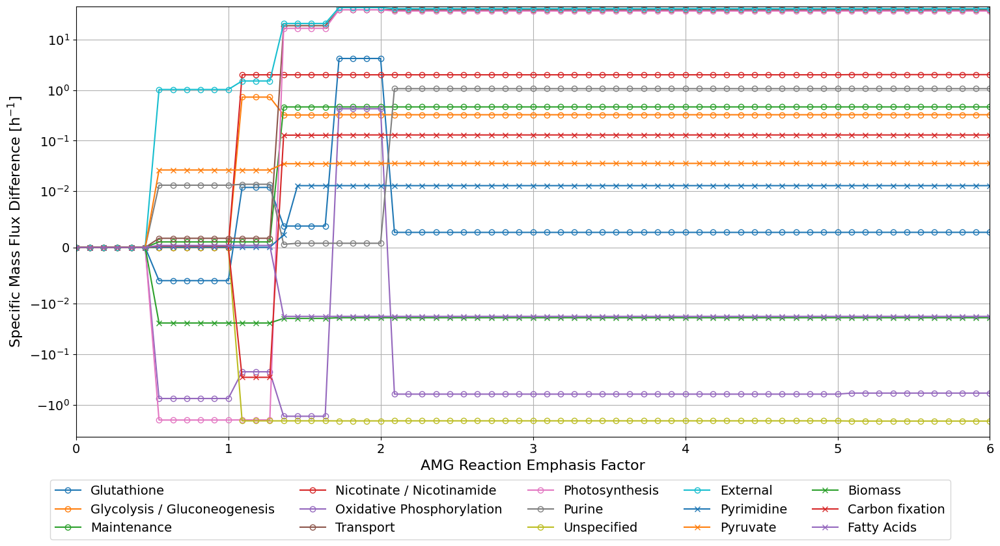

In [38]:
fig, ax = plt.subplots(1, 1, figsize=(16, 8), sharex=True)

ax = sys_diffs_in[
    [
        col
        for col in sys_diffs_in.columns
        if (sys_diffs_in[col].abs().max() > 0.300) or "AMG" in col
    ]
].plot(x="AMG Emphasis Factor", marker="o", fillstyle="none", ax=ax, legend=False)

ax = sys_diffs_in[
    [
        col
        for col in sys_diffs_in.columns
        if (0.300 >= sys_diffs_in[col].abs().max() > 0.010) or "AMG" in col
    ]
].plot(x="AMG Emphasis Factor", marker="x", fillstyle="none", ax=ax, legend=False)
ax.set_yscale("symlog", linthresh=0.01)
ax.tick_params(labelsize=14)
fig.legend(ncols=5, loc="upper center", bbox_to_anchor=(0.5, 0.05), fontsize=14)
ax.set_xlim(0, 6)
ax.set_xlabel("AMG Reaction Emphasis Factor", fontsize=16)
ax.set_ylabel(
    r"Specific Mass Flux Difference [h$^{-1}$]",
    fontsize=16,
)
ax.grid(True, which="both")

fig.tight_layout(pad=3.0)
plt.show()

In [73]:
model.reactions.R01523

Reaction identifier,R01523
Name,ATP:D-ribulose-5-phosphate 1-phosphotransferase
Memory address,0x1c6df2a1d30
Stoichiometry,ATP[c] + D_Ribulose_5_phosphate[c] <=> ADP[c] + D_Ribulose_1_5_bisphosphate[c] ATP + D-Ribulose 5-phosphate <=> ADP + D-Ribulose 1_5-bisphosphate
GPR,PMM0785
Lower bound,-1000.0
Upper bound,1000.0


In [74]:
model.reactions.R01063

Reaction identifier,R01063
Name,R01063
Memory address,0x1c6df63b140
Stoichiometry,D_Glyceraldehyde_3_phosphate[c] + NADP[c] + Orthophosphate[c] <=> 3_Phospho_D_glyceroyl_phosphate[c] + H[c] + NADPH[c] D-Glyceraldehyde 3-phosphate + NADP+ + Orthophosphate <=> 3-Phospho-D-glyceroyl phosphate + H+ + NADPH
GPR,PMM0023
Lower bound,-1000.0
Upper bound,1000.0


In [75]:
amgs

{'R00311': 'raw increase',
 'R05817': 'raw increase',
 'R05818': 'raw increase',
 'PSIIabs': 'raw increase',
 'R01063': 'absolute decrease',
 'R01523': 'absolute decrease',
 'R01827': 'absolute increase',
 'R05223': 'raw increase',
 'R00426': 'raw increase',
 'R00662': 'raw increase'}

In [59]:
amgs_g1 = {
    k: v for k, v in amgs.items() if k in ["PSIIabs", "R00311", "R00426", "R00662"]
}
amgs_g2 = {k: v for k, v in amgs.items() if k in ["R01523", "R05223", "R05817"]}

assert all(k in amgs for k in amgs_g1)
assert all(k in amgs for k in amgs_g2)

{'R00311': 'raw increase',
 'PSIIabs': 'raw increase',
 'R00426': 'raw increase',
 'R00662': 'raw increase'}

In [66]:
infecteds_g1 = []
diffs_g1 = []
baseline = amg_impact_by_parsimony(model, amgs_g1, new_amg_penalty=0)
for amg_penalty in penalties:
    infected_g1 = amg_impact_by_parsimony(model, amgs_g1, new_amg_penalty=-amg_penalty)
    diff_g1 = infected_g1.fluxes - baseline.fluxes

    diffs_g1.append(diff_g1)

    infecteds_g1.append(infected_g1)


infecteds_g1 = pd.DataFrame(infecteds_g1, index=penalties)

absdiffs_g1 = pd.DataFrame(
    [
        infected_g1.fluxes.abs() - baseline.fluxes.abs()
        for infected_g1, baseline in zip(
            infecteds_g1.values.flatten(), baselines.values.flatten()
        )
    ],
    index=penalties,
)

diffs_g1 = pd.DataFrame(diffs_g1, index=penalties)


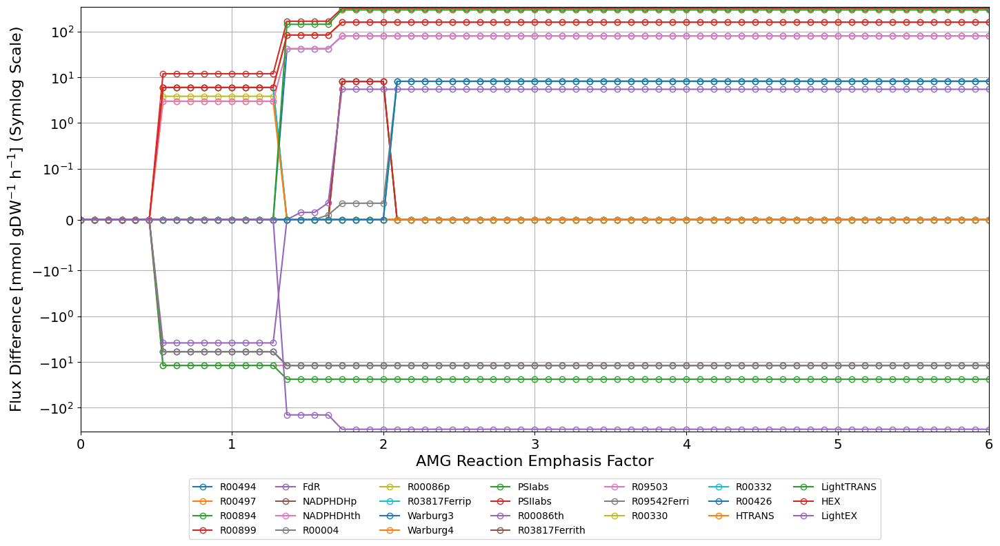

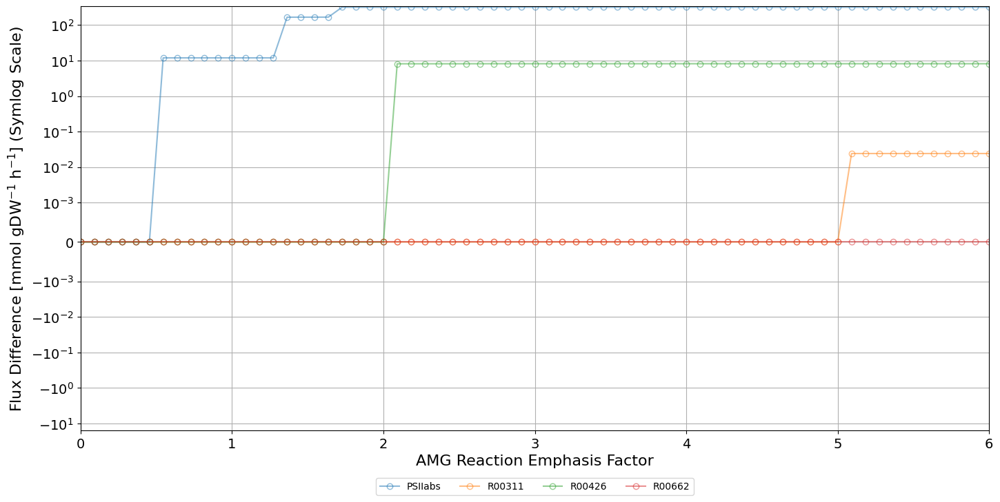

In [71]:
ax = diffs_g1[
    [col for col in diffs_g1.columns if (diffs_g1[col].abs().max() > 0.1)]
].plot(figsize=(17, 8), marker="o", fillstyle="none")
ax.set_yscale("symlog", linthresh=1e-1)
plt.tick_params(labelsize=14)
ax.legend(ncols=7, loc="upper center", bbox_to_anchor=(0.5, -0.1))
ax.set_xlim(0, 6)
ax.set_xlabel("AMG Reaction Emphasis Factor", fontsize=16)
ax.set_ylabel(r"Flux Difference [mmol gDW$^{-1}$ h$^{-1}$] (Symlog Scale)", fontsize=16)
ax.grid(True, which="both")
plt.show()
ax = (
    absdiffs_g1[[col for col in absdiffs_g1.columns if (col in amgs_g1)]]
    # * np.random.uniform(0.9, 1.1, (len(diffs), 10))
).plot(figsize=(17, 8), marker="o", alpha=0.5, fillstyle="none")
ax.set_yscale("symlog", linthresh=1e-3)
plt.tick_params(labelsize=14)
ax.legend(ncols=10, loc="upper center", bbox_to_anchor=(0.5, -0.1))
ax.set_xlim(0, 6)
ax.set_xlabel("AMG Reaction Emphasis Factor", fontsize=16)
ax.set_ylabel(r"Flux Difference [mmol gDW$^{-1}$ h$^{-1}$] (Symlog Scale)", fontsize=16)
ax.grid(True, which="both")
plt.show()

In [67]:
infecteds_g2 = []
diffs_g2 = []
baseline = amg_impact_by_parsimony(model, amgs_g2, new_amg_penalty=0)
for amg_penalty in penalties:
    infected_g2 = amg_impact_by_parsimony(model, amgs_g2, new_amg_penalty=-amg_penalty)
    diff_g2 = infected_g2.fluxes - baseline.fluxes

    diffs_g2.append(diff_g2)

    infecteds_g2.append(infected_g2)


infecteds_g2 = pd.DataFrame(infecteds_g2, index=penalties)

absdiffs_g2 = pd.DataFrame(
    [
        infected_g2.fluxes.abs() - baseline.fluxes.abs()
        for infected_g2, baseline in zip(
            infecteds_g2.values.flatten(), baselines.values.flatten()
        )
    ],
    index=penalties,
)

diffs_g2 = pd.DataFrame(diffs_g2, index=penalties)

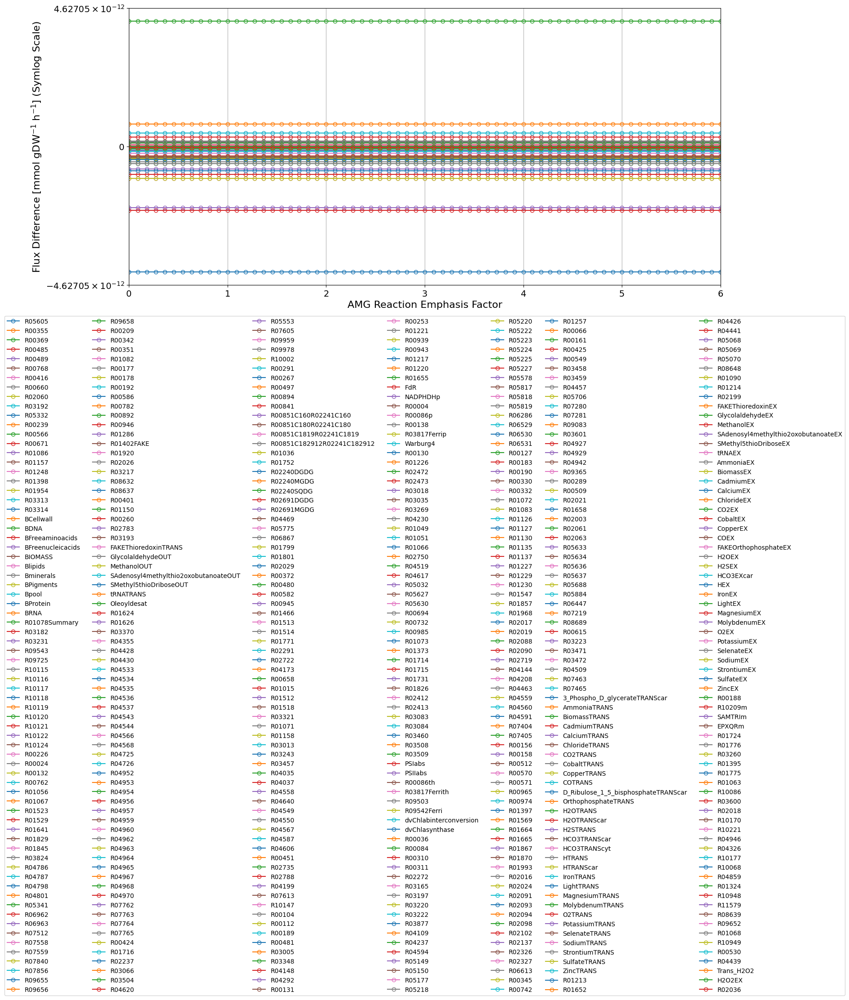

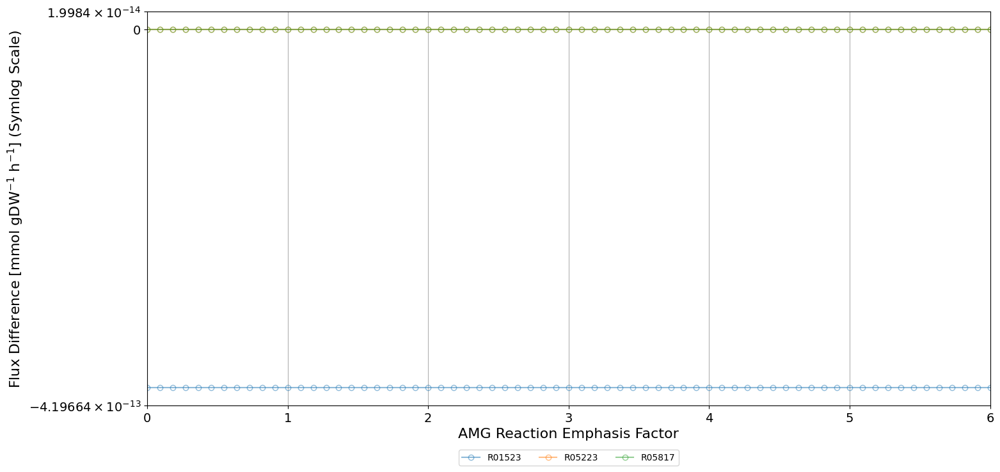

In [72]:
ax = diffs_g2[
    [col for col in diffs_g2.columns if (diffs_g2[col].abs().max() > 0.0)]
].plot(figsize=(17, 8), marker="o", fillstyle="none")
ax.set_yscale("symlog", linthresh=1e-1)
plt.tick_params(labelsize=14)
ax.legend(ncols=7, loc="upper center", bbox_to_anchor=(0.5, -0.1))
ax.set_xlim(0, 6)
ax.set_xlabel("AMG Reaction Emphasis Factor", fontsize=16)
ax.set_ylabel(r"Flux Difference [mmol gDW$^{-1}$ h$^{-1}$] (Symlog Scale)", fontsize=16)
ax.grid(True, which="both")
plt.show()
ax = (
    absdiffs_g2[[col for col in absdiffs_g2.columns if (col in amgs_g2)]]
    # * np.random.uniform(0.9, 1.1, (len(diffs), 10))
).plot(figsize=(17, 8), marker="o", alpha=0.5, fillstyle="none")
ax.set_yscale("symlog", linthresh=1e-3)
plt.tick_params(labelsize=14)
ax.legend(ncols=10, loc="upper center", bbox_to_anchor=(0.5, -0.1))
ax.set_xlim(0, 6)
ax.set_xlabel("AMG Reaction Emphasis Factor", fontsize=16)
ax.set_ylabel(r"Flux Difference [mmol gDW$^{-1}$ h$^{-1}$] (Symlog Scale)", fontsize=16)
ax.grid(True, which="both")
plt.show()

In [9]:
permissive_fva = cobra.flux_analysis.flux_variability_analysis(
    model, fraction_of_optimum=0.0
)

PSIIabs optimal
1 Amino_sugars[c]
2 Free_fatty_acids[c]
3 Amino_sugars[e]
4 Free_fatty_acids[e]
R00311 optimal
R00426 optimal
R00662 optimal
R01063 optimal
R01523 optimal
R01827 optimal
R05223 optimal
R05817 optimal
R05818 optimal


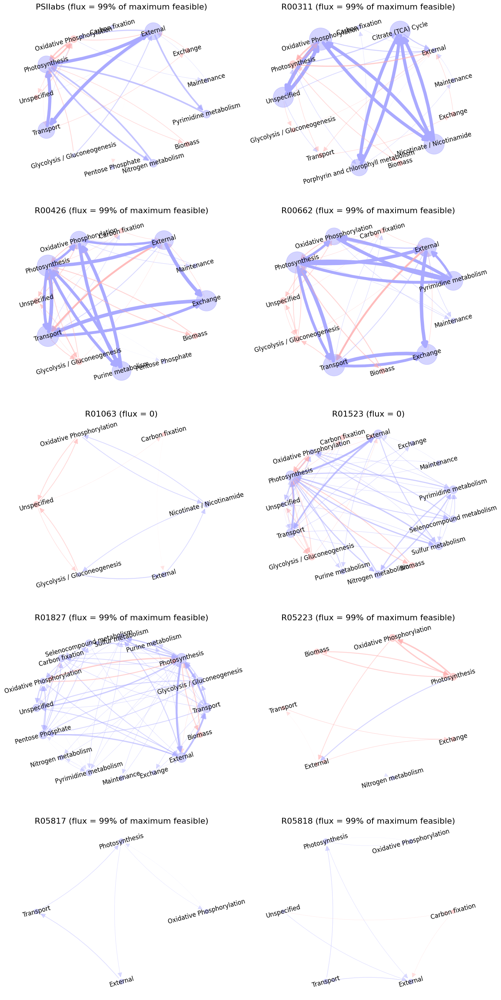

In [14]:
fig, axs = plt.subplots(5, 2, figsize=(16, 35))
for amg, ax in zip(sorted(amgs), axs.flatten()):
    with model as smodel:
        suffix = ""
        if amgs[amg] == "raw increase" or amgs[amg] == "absolute increase":
            smodel.reactions.get_by_id(amg).lower_bound = (
                permissive_fva["maximum"][amg] * 0.99
            )
            suffix = r"(flux = 99% of maximum feasible)"
            # continue
        if amgs[amg] == "absolute decrease":
            smodel.reactions.get_by_id(amg).lower_bound = 0
            smodel.reactions.get_by_id(amg).upper_bound = 0
            suffix = "(flux = 0)"
            # continue
        smoma = cobra.flux_analysis.moma(smodel, baseline)
        go = gu.subsystem_flux_graph(smodel, baseline, masses=masses)
        gp = gu.subsystem_flux_graph(smodel, smoma, masses=masses)
        gd = gu.diff_graph(gp, go)
        ax.xaxis.set_ticks_position("none")
        ax.yaxis.set_ticks_position("none")
        ax.xaxis.set_major_locator(plt.NullLocator())
        ax.yaxis.set_major_locator(plt.NullLocator())
        draw_graph(gd, ax, cut=1, manual_relabels=manual_relabels, scale=250)
        ax.set_title(f"{amg} {suffix}", fontsize=16)
        print(amg, smoma.status)
plt.show()

PSIIabs R00311 optimal


c:\Users\rozu775\Documents\Code\nwbrave\dfbahv\.venv\Lib\site-packages\cobra\util\solver.py:554: UserWarning: Solver status is 'infeasible'.
  warn(f"Solver status is '{status}'.", UserWarning)


PSIIabs R00426 infeasible
PSIIabs R00662 infeasible
PSIIabs R01063 optimal
PSIIabs R01523 optimal
PSIIabs R01827 optimal
PSIIabs R05223 infeasible
PSIIabs R05817 infeasible
PSIIabs R05818 infeasible
R00311 R00426 infeasible
R00311 R00662 infeasible
R00311 R01063 optimal
R00311 R01523 optimal
R00311 R01827 optimal
R00311 R05223 optimal
R00311 R05817 infeasible
R00311 R05818 infeasible
R00426 R00662 infeasible
R00426 R01063 optimal
R00426 R01523 optimal
R00426 R01827 infeasible
R00426 R05223 infeasible
R00426 R05817 infeasible
R00426 R05818 infeasible
R00662 R01063 optimal
R00662 R01523 optimal
R00662 R01827 infeasible
R00662 R05223 infeasible
R00662 R05817 infeasible
R00662 R05818 infeasible
R01063 R01523 optimal
R01063 R01827 optimal
R01063 R05223 optimal
R01063 R05817 optimal
R01063 R05818 optimal
R01523 R01827 infeasible
R01523 R05223 infeasible
R01523 R05817 infeasible
R01523 R05818 infeasible
R01827 R05223 infeasible
R01827 R05817 infeasible
R01827 R05818 infeasible
R05223 R05817 i

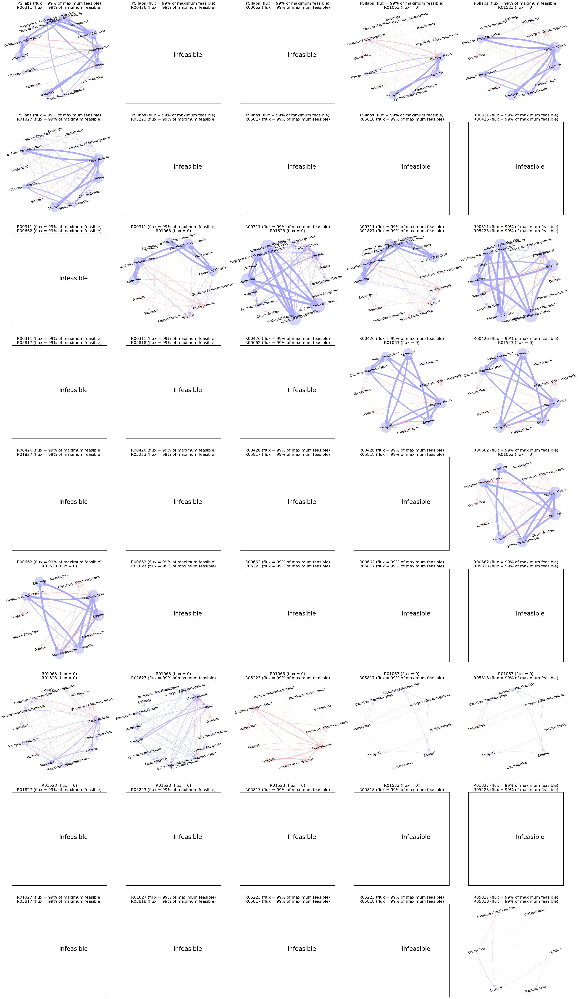

In [477]:
fig, axs = plt.subplots(9, 5, figsize=(40, 72))
for (amg1, amg2), ax in zip(combinations(sorted(amgs), 2), axs.flatten()):
    with model as smodel:
        suffix1 = ""
        suffix2 = ""
        if amgs[amg1] == "raw increase" or amgs[amg1] == "absolute increase":
            smodel.reactions.get_by_id(amg1).lower_bound = (
                permissive_fva["maximum"][amg1] * 0.99
            )
            suffix1 = r"(flux = 99% of maximum feasible)"
        if amgs[amg1] == "absolute decrease":
            smodel.reactions.get_by_id(amg1).lower_bound = 0
            smodel.reactions.get_by_id(amg1).upper_bound = 0
            suffix1 = "(flux = 0)"

        if amgs[amg2] == "raw increase" or amgs[amg2] == "absolute increase":
            smodel.reactions.get_by_id(amg2).lower_bound = (
                permissive_fva["maximum"][amg2] * 0.99
            )
            suffix2 = r"(flux = 99% of maximum feasible)"
        if amgs[amg2] == "absolute decrease":
            smodel.reactions.get_by_id(amg2).lower_bound = 0
            smodel.reactions.get_by_id(amg2).upper_bound = 0
            suffix2 = "(flux = 0)"

        smoma = cobra.flux_analysis.moma(smodel, baseline)
        go = gu.subsystem_flux_graph(smodel, baseline, masses=masses)
        gp = gu.subsystem_flux_graph(smodel, smoma, masses=masses)
        gd = gu.diff_graph(gp, go)
        ax.xaxis.set_ticks_position("none")
        ax.yaxis.set_ticks_position("none")
        ax.xaxis.set_major_locator(plt.NullLocator())
        ax.yaxis.set_major_locator(plt.NullLocator())

        if smoma.status == "optimal":
            draw_graph(gd, ax, cut=1, manual_relabels=manual_relabels, scale=250)
        else:
            ax.annotate("Infeasible", xy=(0.5, 0.5), xytext=(0.5, 0.5), fontsize=24)
        ax.set_title(f"{amg1} {suffix1}\n{amg2} {suffix2}", fontsize=16)
        print(amg1, amg2, smoma.status)
plt.show()

PSIIabs PSIIabs optimal
PSIIabs R00311 optimal
PSIIabs R00426 optimal
PSIIabs R00662 optimal
PSIIabs R01063 optimal
PSIIabs R01523 optimal
PSIIabs R01827 optimal
PSIIabs R05223 optimal
PSIIabs R05817 optimal
PSIIabs R05818 optimal
R00311 R00311 optimal
R00311 R00426 optimal
R00311 R00662 optimal
R00311 R01063 optimal
R00311 R01523 optimal
R00311 R01827 optimal
R00311 R05223 optimal
R00311 R05817 optimal
R00311 R05818 optimal
R00426 R00426 optimal
R00426 R00662 optimal
R00426 R01063 optimal
R00426 R01523 optimal
R00426 R01827 optimal
R00426 R05223 optimal
R00426 R05817 optimal
R00426 R05818 optimal
R00662 R00662 optimal
R00662 R01063 optimal
R00662 R01523 optimal
R00662 R01827 optimal
R00662 R05223 optimal
R00662 R05817 optimal
R00662 R05818 optimal
R01063 R01063 optimal
R01063 R01523 optimal
R01063 R01827 optimal
R01063 R05223 optimal
R01063 R05817 optimal
R01063 R05818 optimal
R01523 R01523 optimal


c:\Users\rozu775\Documents\Code\nwbrave\dfbahv\.venv\Lib\site-packages\cobra\util\solver.py:554: UserWarning: Solver status is 'infeasible'.
  warn(f"Solver status is '{status}'.", UserWarning)


R01523 R01827 infeasible
R01523 R05223 infeasible
R01523 R05817 infeasible
R01523 R05818 infeasible
R01827 R01827 optimal
R01827 R05223 optimal
R01827 R05817 optimal
R01827 R05818 optimal
R05223 R05223 optimal
R05223 R05817 optimal
R05223 R05818 optimal
R05817 R05817 optimal
R05817 R05818 optimal
R05818 R05818 optimal


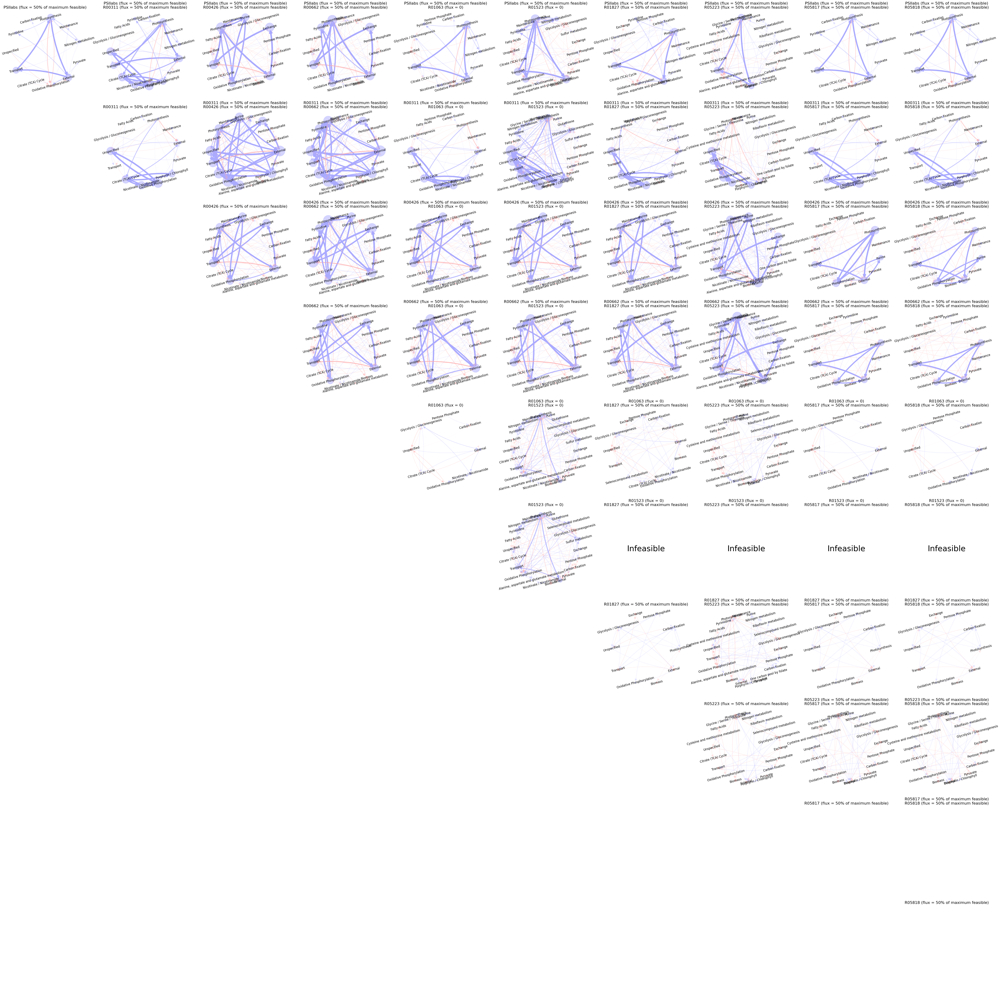

In [40]:
fig, axs = plt.subplots(10, 10, figsize=(72, 72))

for ax in axs.flatten():
    ax.xaxis.set_ticks_position("none")
    ax.yaxis.set_ticks_position("none")
    ax.xaxis.set_major_locator(plt.NullLocator())
    ax.yaxis.set_major_locator(plt.NullLocator())
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    ax.spines["bottom"].set_visible(False)
    ax.spines["left"].set_visible(False)

for (i, amg1), (j, amg2) in combinations_with_replacement(enumerate(sorted(amgs)), 2):
    with model as smodel:
        ax = axs[i][j]
        suffix1 = ""
        suffix2 = ""
        if amgs[amg1] == "raw increase" or amgs[amg1] == "absolute increase":
            smodel.reactions.get_by_id(amg1).lower_bound = (
                permissive_fva["maximum"][amg1] * 0.50
            )
            suffix1 = r"(flux = 50% of maximum feasible)"
        if amgs[amg1] == "absolute decrease":
            smodel.reactions.get_by_id(amg1).lower_bound = 0
            smodel.reactions.get_by_id(amg1).upper_bound = 0
            suffix1 = "(flux = 0)"

        if amgs[amg2] == "raw increase" or amgs[amg2] == "absolute increase":
            smodel.reactions.get_by_id(amg2).lower_bound = (
                permissive_fva["maximum"][amg2] * 0.50
            )
            suffix2 = r"(flux = 50% of maximum feasible)"
        if amgs[amg2] == "absolute decrease":
            smodel.reactions.get_by_id(amg2).lower_bound = 0
            smodel.reactions.get_by_id(amg2).upper_bound = 0
            suffix2 = "(flux = 0)"

        smoma = cobra.flux_analysis.moma(smodel, baseline)
        go = gu.subsystem_flux_graph(smodel, baseline, masses=masses)
        gp = gu.subsystem_flux_graph(smodel, smoma, masses=masses)
        gd = gu.diff_graph(gp, go)
        ax.xaxis.set_ticks_position("none")
        ax.yaxis.set_ticks_position("none")
        ax.xaxis.set_major_locator(plt.NullLocator())
        ax.yaxis.set_major_locator(plt.NullLocator())

        if smoma.status == "optimal":
            draw_graph(gd, ax, cut=30 / 300, manual_relabels=manual_relabels, scale=300)
        else:
            ax.annotate(
                "Infeasible",
                xy=(0.5, 0.5),
                xytext=(0.5, 0.5),
                fontsize=32,
                horizontalalignment="center",
                verticalalignment="center",
            )
        if i != j:
            ax.set_title(f"{amg1} {suffix1}\n{amg2} {suffix2}", fontsize=16)
        else:
            ax.set_title(f"{amg1} {suffix1}", fontsize=16)
        print(amg1, amg2, smoma.status)
plt.show()

PSIIabs PSIIabs optimal
PSIIabs R00311 optimal
PSIIabs R00426 infeasible
PSIIabs R00662 infeasible
PSIIabs R01063 optimal
PSIIabs R01523 optimal
PSIIabs R01827 optimal
PSIIabs R05223 infeasible
PSIIabs R05817 infeasible
PSIIabs R05818 infeasible
R00311 R00311 optimal
R00311 R00426 infeasible
R00311 R00662 infeasible
R00311 R01063 optimal
R00311 R01523 optimal
R00311 R01827 optimal
R00311 R05223 optimal
R00311 R05817 infeasible
R00311 R05818 infeasible
R00426 R00426 optimal
R00426 R00662 infeasible
R00426 R01063 optimal
R00426 R01523 optimal
R00426 R01827 infeasible
R00426 R05223 infeasible
R00426 R05817 infeasible
R00426 R05818 infeasible
R00662 R00662 optimal
R00662 R01063 optimal
R00662 R01523 optimal
R00662 R01827 infeasible
R00662 R05223 infeasible
R00662 R05817 infeasible
R00662 R05818 infeasible
R01063 R01063 optimal
R01063 R01523 optimal
R01063 R01827 optimal
R01063 R05223 optimal
R01063 R05817 optimal
R01063 R05818 optimal
R01523 R01523 optimal
R01523 R01827 infeasible
R01523 R

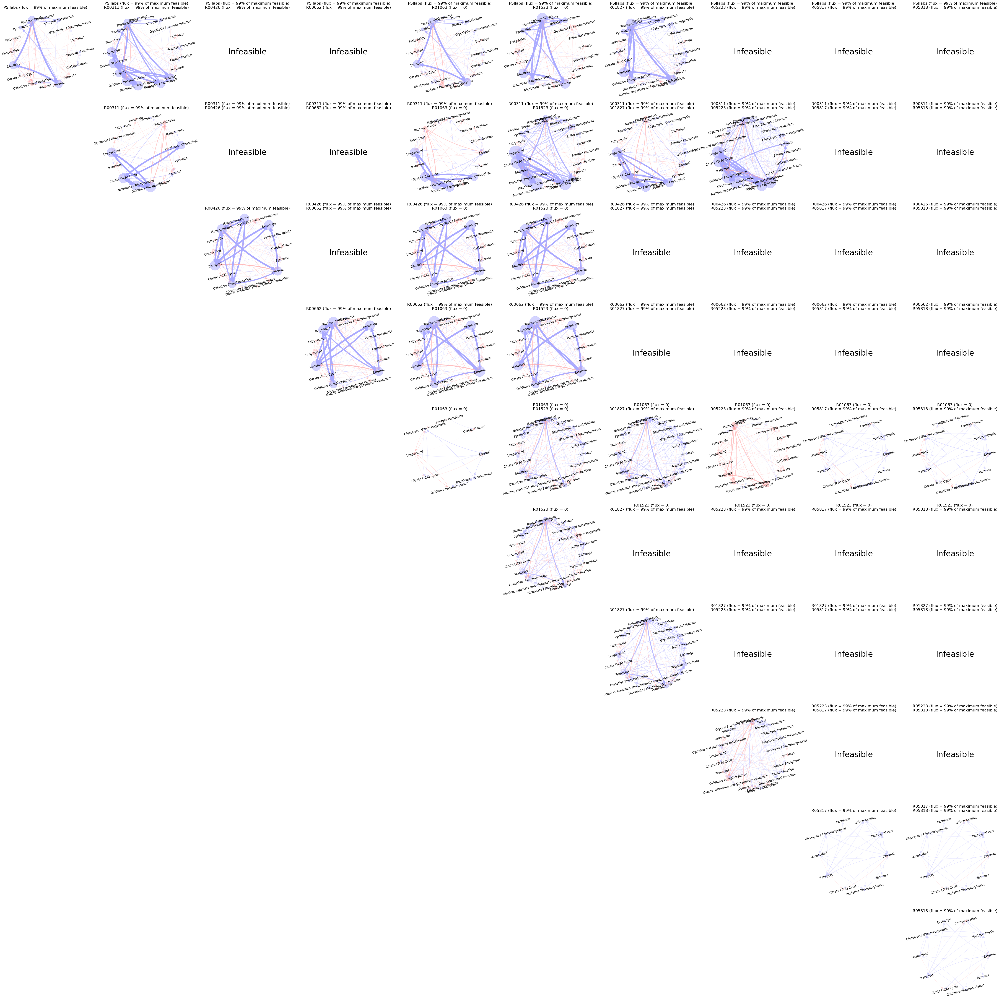

In [41]:
fig, axs = plt.subplots(10, 10, figsize=(72, 72))

for ax in axs.flatten():
    ax.xaxis.set_ticks_position("none")
    ax.yaxis.set_ticks_position("none")
    ax.xaxis.set_major_locator(plt.NullLocator())
    ax.yaxis.set_major_locator(plt.NullLocator())
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    ax.spines["bottom"].set_visible(False)
    ax.spines["left"].set_visible(False)

for (i, amg1), (j, amg2) in combinations_with_replacement(enumerate(sorted(amgs)), 2):
    with model as smodel:
        ax = axs[i][j]
        suffix1 = ""
        suffix2 = ""
        if amgs[amg1] == "raw increase" or amgs[amg1] == "absolute increase":
            smodel.reactions.get_by_id(amg1).lower_bound = (
                permissive_fva["maximum"][amg1] * 0.99
            )
            suffix1 = r"(flux = 99% of maximum feasible)"
        if amgs[amg1] == "absolute decrease":
            smodel.reactions.get_by_id(amg1).lower_bound = 0
            smodel.reactions.get_by_id(amg1).upper_bound = 0
            suffix1 = "(flux = 0)"

        if amgs[amg2] == "raw increase" or amgs[amg2] == "absolute increase":
            smodel.reactions.get_by_id(amg2).lower_bound = (
                permissive_fva["maximum"][amg2] * 0.99
            )
            suffix2 = r"(flux = 99% of maximum feasible)"
        if amgs[amg2] == "absolute decrease":
            smodel.reactions.get_by_id(amg2).lower_bound = 0
            smodel.reactions.get_by_id(amg2).upper_bound = 0
            suffix2 = "(flux = 0)"

        smoma = cobra.flux_analysis.moma(smodel, baseline)
        go = gu.subsystem_flux_graph(smodel, baseline, masses=masses)
        gp = gu.subsystem_flux_graph(smodel, smoma, masses=masses)
        gd = gu.diff_graph(gp, go)
        ax.xaxis.set_ticks_position("none")
        ax.yaxis.set_ticks_position("none")
        ax.xaxis.set_major_locator(plt.NullLocator())
        ax.yaxis.set_major_locator(plt.NullLocator())

        if smoma.status == "optimal":
            draw_graph(gd, ax, cut=30 / 300, manual_relabels=manual_relabels, scale=300)
        else:
            ax.annotate(
                "Infeasible",
                xy=(0.5, 0.5),
                xytext=(0.5, 0.5),
                fontsize=32,
                horizontalalignment="center",
                verticalalignment="center",
            )
        if i != j:
            ax.set_title(f"{amg1} {suffix1}\n{amg2} {suffix2}", fontsize=16)
        else:
            ax.set_title(f"{amg1} {suffix1}", fontsize=16)
        print(amg1, amg2, smoma.status)
plt.show()

R00662 R00662 optimal
R01523 R01523 optimal
R05817 R05817 optimal
R00662 R01523 optimal
R00662 R05817 optimal
R01523 R05817 infeasible


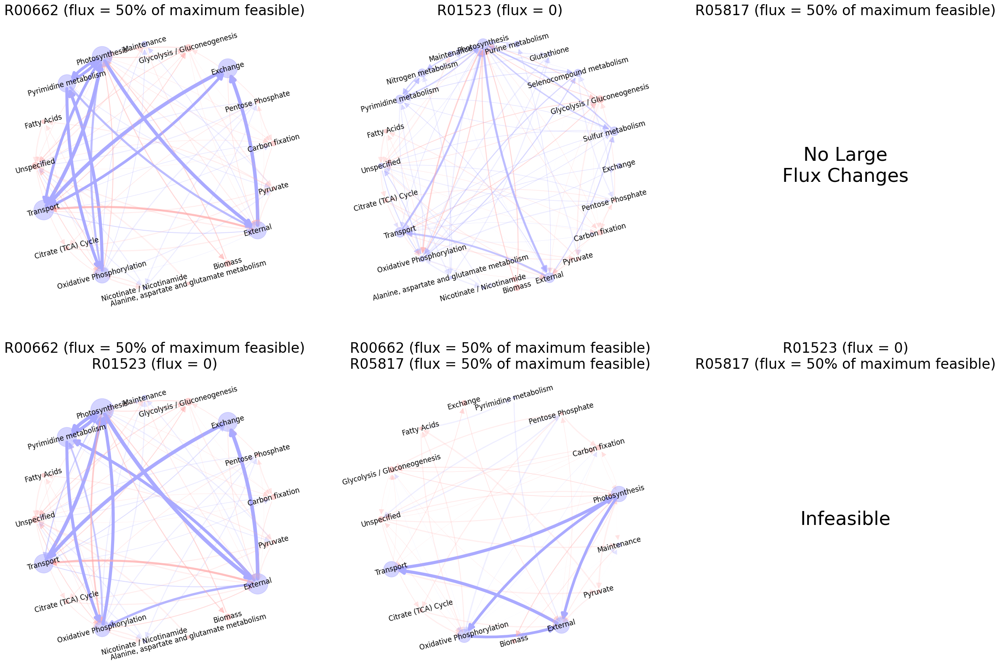

In [27]:
fig, axs = plt.subplots(2, 3, figsize=(30, 20))

for ax in axs.flatten():
    ax.xaxis.set_ticks_position("none")
    ax.yaxis.set_ticks_position("none")
    ax.xaxis.set_major_locator(plt.NullLocator())
    ax.yaxis.set_major_locator(plt.NullLocator())
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    ax.spines["bottom"].set_visible(False)
    ax.spines["left"].set_visible(False)

order = [
    ((0, "R00662"), (0, "R00662")),
    ((0, "R01523"), (1, "R01523")),
    ((0, "R05817"), (2, "R05817")),
    ((1, "R00662"), (0, "R01523")),
    ((1, "R00662"), (1, "R05817")),
    ((1, "R01523"), (2, "R05817")),
]

for (i, amg1), (j, amg2) in order:
    with model as smodel:
        ax = axs[i][j]
        suffix1 = ""
        suffix2 = ""
        if amgs[amg1] == "raw increase" or amgs[amg1] == "absolute increase":
            smodel.reactions.get_by_id(amg1).lower_bound = (
                permissive_fva["maximum"][amg1] * 0.50
            )
            suffix1 = r"(flux = 50% of maximum feasible)"
        if amgs[amg1] == "absolute decrease":
            smodel.reactions.get_by_id(amg1).lower_bound = 0
            smodel.reactions.get_by_id(amg1).upper_bound = 0
            suffix1 = "(flux = 0)"

        if amgs[amg2] == "raw increase" or amgs[amg2] == "absolute increase":
            smodel.reactions.get_by_id(amg2).lower_bound = (
                permissive_fva["maximum"][amg2] * 0.50
            )
            suffix2 = r"(flux = 50% of maximum feasible)"
        if amgs[amg2] == "absolute decrease":
            smodel.reactions.get_by_id(amg2).lower_bound = 0
            smodel.reactions.get_by_id(amg2).upper_bound = 0
            suffix2 = "(flux = 0)"

        smoma = cobra.flux_analysis.moma(smodel, baseline)
        go = gu.subsystem_flux_graph(smodel, baseline, masses=masses)
        gp = gu.subsystem_flux_graph(smodel, smoma, masses=masses)
        gd = gu.diff_graph(gp, go)
        ax.xaxis.set_ticks_position("none")
        ax.yaxis.set_ticks_position("none")
        ax.xaxis.set_major_locator(plt.NullLocator())
        ax.yaxis.set_major_locator(plt.NullLocator())

        if smoma.status == "optimal":
            draw_graph(gd, ax, cut=30 / 300, manual_relabels=manual_relabels, scale=300)
        else:
            ax.annotate(
                "Infeasible",
                xy=(0.5, 0.5),
                xytext=(0.5, 0.5),
                fontsize=32,
                horizontalalignment="center",
                verticalalignment="center",
            )
        if amg1 == amg2 == "R05817":
            ax.annotate(
                "No Large\nFlux Changes",
                xy=(0.5, 0.5),
                xytext=(0.5, 0.5),
                fontsize=32,
                horizontalalignment="center",
                verticalalignment="center",
            )
        if amg1 != amg2:
            ax.set_title(f"{amg1} {suffix1}\n{amg2} {suffix2}", fontsize=24)
        else:
            ax.set_title(f"{amg1} {suffix1}", fontsize=24)
        print(amg1, amg2, smoma.status)
plt.show()

R00662 R00662 optimal
R05817 R05817 optimal
R00662 R05817 optimal
R01063 R01063 optimal
R05223 R05223 optimal
R01063 R05223 optimal


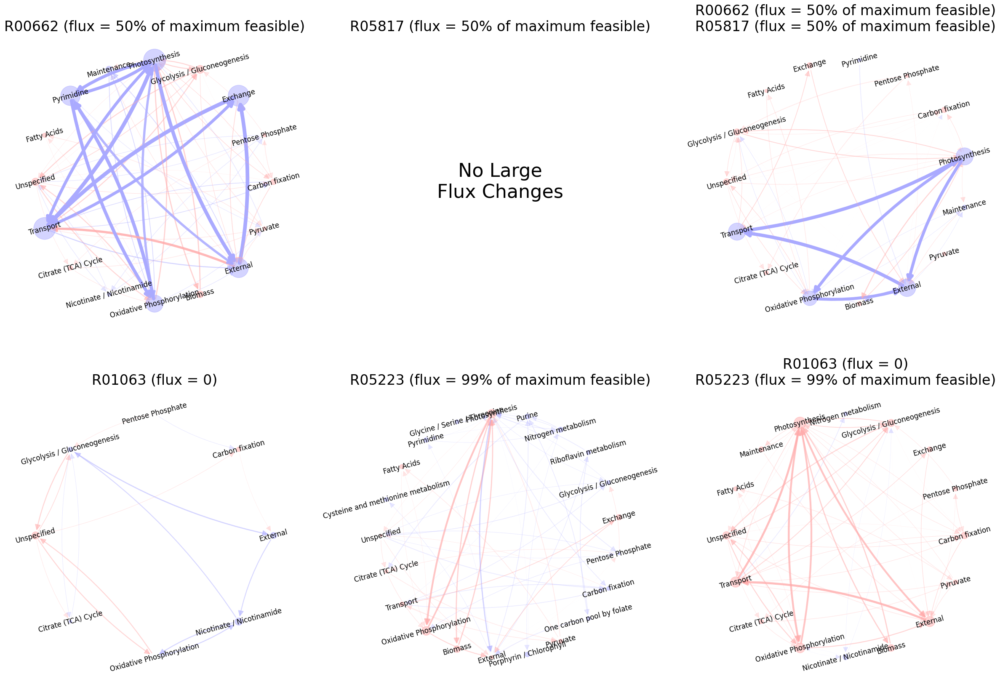

In [34]:
fig, axs = plt.subplots(2, 3, figsize=(30, 20))

for ax in axs.flatten():
    ax.xaxis.set_ticks_position("none")
    ax.yaxis.set_ticks_position("none")
    ax.xaxis.set_major_locator(plt.NullLocator())
    ax.yaxis.set_major_locator(plt.NullLocator())
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    ax.spines["bottom"].set_visible(False)
    ax.spines["left"].set_visible(False)

order = [
    ((0, "R00662"), (0, "R00662")),
    ((0, "R05817"), (1, "R05817")),
    ((0, "R00662"), (2, "R05817")),
    ((1, "R01063"), (0, "R01063")),
    ((1, "R05223"), (1, "R05223")),
    ((1, "R01063"), (2, "R05223")),
]

for (i, amg1), (j, amg2) in order:
    with model as smodel:
        ax = axs[i][j]
        suffix1 = ""
        suffix2 = ""
        if i == 0:
            if amgs[amg1] == "raw increase" or amgs[amg1] == "absolute increase":
                smodel.reactions.get_by_id(amg1).lower_bound = (
                    permissive_fva["maximum"][amg1] * 0.50
                )
                suffix1 = r"(flux = 50% of maximum feasible)"
            if amgs[amg1] == "absolute decrease":
                smodel.reactions.get_by_id(amg1).lower_bound = 0
                smodel.reactions.get_by_id(amg1).upper_bound = 0
                suffix1 = "(flux = 0)"

            if amgs[amg2] == "raw increase" or amgs[amg2] == "absolute increase":
                smodel.reactions.get_by_id(amg2).lower_bound = (
                    permissive_fva["maximum"][amg2] * 0.50
                )
                suffix2 = r"(flux = 50% of maximum feasible)"
            if amgs[amg2] == "absolute decrease":
                smodel.reactions.get_by_id(amg2).lower_bound = 0
                smodel.reactions.get_by_id(amg2).upper_bound = 0
                suffix2 = "(flux = 0)"
        elif i == 1:
            if amgs[amg1] == "raw increase" or amgs[amg1] == "absolute increase":
                smodel.reactions.get_by_id(amg1).lower_bound = (
                    permissive_fva["maximum"][amg1] * 0.99
                )
                suffix1 = r"(flux = 99% of maximum feasible)"
            if amgs[amg1] == "absolute decrease":
                smodel.reactions.get_by_id(amg1).lower_bound = 0
                smodel.reactions.get_by_id(amg1).upper_bound = 0
                suffix1 = "(flux = 0)"

            if amgs[amg2] == "raw increase" or amgs[amg2] == "absolute increase":
                smodel.reactions.get_by_id(amg2).lower_bound = (
                    permissive_fva["maximum"][amg2] * 0.99
                )
                suffix2 = r"(flux = 99% of maximum feasible)"
            if amgs[amg2] == "absolute decrease":
                smodel.reactions.get_by_id(amg2).lower_bound = 0
                smodel.reactions.get_by_id(amg2).upper_bound = 0
                suffix2 = "(flux = 0)"

        smoma = cobra.flux_analysis.moma(smodel, baseline)
        go = gu.subsystem_flux_graph(smodel, baseline, masses=masses)
        gp = gu.subsystem_flux_graph(smodel, smoma, masses=masses)
        gd = gu.diff_graph(gp, go)
        ax.xaxis.set_ticks_position("none")
        ax.yaxis.set_ticks_position("none")
        ax.xaxis.set_major_locator(plt.NullLocator())
        ax.yaxis.set_major_locator(plt.NullLocator())

        if smoma.status == "optimal":
            draw_graph(gd, ax, cut=50 / 200, manual_relabels=manual_relabels, scale=200)
        else:
            ax.annotate(
                "Infeasible",
                xy=(0.5, 0.5),
                xytext=(0.5, 0.5),
                fontsize=32,
                horizontalalignment="center",
                verticalalignment="center",
            )
        if amg1 == amg2 == "R05817":
            ax.annotate(
                "No Large\nFlux Changes",
                xy=(0.5, 0.5),
                xytext=(0.5, 0.5),
                fontsize=32,
                horizontalalignment="center",
                verticalalignment="center",
            )
        if amg1 != amg2:
            ax.set_title(f"{amg1} {suffix1}\n{amg2} {suffix2}", fontsize=24)
        else:
            ax.set_title(f"{amg1} {suffix1}", fontsize=24)
        print(amg1, amg2, smoma.status)
plt.show()